In [1]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')


Mounted at /content/drive


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import timm
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sys
from tqdm.notebook import tqdm

# Dataset


In [3]:
class PlayingCardDataset(Dataset):
  def __init__(self, data_dir, transform=None):
    self.data = ImageFolder(data_dir, transform=transform)
  def __len__(self):
    return len(self.data)
  def __getitem__(self, idx):
    return self.data[idx]

    def classes(self):
      return self.data.classes


In [4]:
dataset = PlayingCardDataset(data_dir = '/content/drive/MyDrive/dataset_cards/train')

In [5]:
data_dir = '/content/drive/MyDrive/dataset_cards/train'
target_to_class = {v: k for k, v in ImageFolder(data_dir).class_to_idx.items()}

In [6]:
print(target_to_class)

{0: 'ace of clubs', 1: 'ace of diamonds', 2: 'ace of hearts', 3: 'ace of spades', 4: 'eight of clubs', 5: 'eight of diamonds', 6: 'eight of hearts', 7: 'eight of spades', 8: 'five of clubs', 9: 'five of diamonds', 10: 'five of hearts', 11: 'five of spades', 12: 'four of clubs', 13: 'four of diamonds', 14: 'four of hearts', 15: 'four of spades', 16: 'jack of clubs', 17: 'jack of diamonds', 18: 'jack of hearts', 19: 'jack of spades', 20: 'joker', 21: 'king of clubs', 22: 'king of diamonds', 23: 'king of hearts', 24: 'king of spades', 25: 'nine of clubs', 26: 'nine of diamonds', 27: 'nine of hearts', 28: 'nine of spades', 29: 'queen of clubs', 30: 'queen of diamonds', 31: 'queen of hearts', 32: 'queen of spades', 33: 'seven of clubs', 34: 'seven of diamonds', 35: 'seven of hearts', 36: 'seven of spades', 37: 'six of clubs', 38: 'six of diamonds', 39: 'six of hearts', 40: 'six of spades', 41: 'ten of clubs', 42: 'ten of diamonds', 43: 'ten of hearts', 44: 'ten of spades', 45: 'three of clu

In [7]:
transform = transforms.Compose([transforms.Resize((128,128)),
                                transforms.ToTensor()])
dataset = PlayingCardDataset(data_dir, transform)

In [8]:
image, label = dataset[100]
image.shape


torch.Size([3, 128, 128])

In [9]:
for image, label in dataset:
  break

#DATALOADER

In [10]:
BATCH_SIZE = 32

dataloader = DataLoader(dataset, batch_size = BATCH_SIZE, shuffle=True)

for images, labels in dataloader:
  break
images.shape

torch.Size([32, 3, 128, 128])

In [11]:
import torch
import timm
import torch.nn as nn

class CardClassifier(nn.Module):
    def __init__(self, num_classes=53):
        super(CardClassifier, self).__init__()
        self.base_model = timm.create_model('efficientnet_b0', pretrained=True)
        self.features = nn.Sequential(*list(self.base_model.children())[:-1])
        enet_out_size = 1280
        self.classifier = nn.Linear(enet_out_size, num_classes)

    def forward(self, x):
        x = self.features(x)
        x = torch.flatten(x, 1)
        output = self.classifier(x)
        return output


In [12]:
model = CardClassifier(num_classes = 53)
print(model)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:104: UserWarning: 
Error while fetching `HF_TOKEN` secret value from your vault: 'Requesting secret HF_TOKEN timed out. Secrets can only be fetched when running from the Colab UI.'.
You are not authenticated with the Hugging Face Hub in this notebook.
If the error persists, please let us know by opening an issue on GitHub (https://github.com/huggingface/huggingface_hub/issues/new).
  warnings.warn(


model.safetensors:   0%|          | 0.00/21.4M [00:00<?, ?B/s]

CardClassifier(
  (base_model): EfficientNet(
    (conv_stem): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNormAct2d(
      32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
      (drop): Identity()
      (act): SiLU(inplace=True)
    )
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn1): BatchNormAct2d(
            32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
            (act): SiLU(inplace=True)
          )
          (aa): Identity()
          (se): SqueezeExcite(
            (conv_reduce): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (act1): SiLU(inplace=True)
            (conv_expand): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (gate): Sigmoid()
          )
          (conv_p

In [13]:
example = model(images)
example.shape

torch.Size([32, 53])

## Training loop

In [14]:
criterion = nn.CrossEntropyLoss()

In [15]:
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [16]:


transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

train_folder = '/content/drive/MyDrive/dataset_cards/train'
valid_folder = '/content/drive/MyDrive/dataset_cards/valid'
test_folder = '/content/drive/MyDrive/dataset_cards/test'

train_dataset = PlayingCardDataset(train_folder, transform=transform)
val_dataset = PlayingCardDataset(valid_folder, transform=transform)
test_dataset = PlayingCardDataset(test_folder, transform=transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)



In [17]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [18]:
# Simple training loop
num_epochs = 5
train_losses, val_losses = [], []

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

model = CardClassifier(num_classes=53)
model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

for epoch in range(num_epochs):
    # Training phase
    model.train()
    running_loss = 0.0
    for images, labels in tqdm(train_loader, desc='Training loop'):
        # Move inputs and labels to the device
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * labels.size(0)
    train_loss = running_loss / len(train_loader.dataset)
    train_losses.append(train_loss)

    # Validation phase
    model.eval()
    running_loss = 0.0
    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc='Validation loop'):
            # Move inputs and labels to the device
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)
            running_loss += loss.item() * labels.size(0)
    val_loss = running_loss / len(val_loader.dataset)
    val_losses.append(val_loss)
    print(f"Epoch {epoch+1}/{num_epochs} - Train loss: {train_loss}, Validation loss: {val_loss}")

Training loop:   0%|          | 0/239 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/9 [00:00<?, ?it/s]

Epoch 1/5 - Train loss: 1.649319693399251, Validation loss: 0.4580351235731593


Training loop:   0%|          | 0/239 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/9 [00:00<?, ?it/s]

Epoch 2/5 - Train loss: 0.5846070604240532, Validation loss: 0.23465018975284865


Training loop:   0%|          | 0/239 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/9 [00:00<?, ?it/s]

Epoch 3/5 - Train loss: 0.3262800947066244, Validation loss: 0.21207098443553132


Training loop:   0%|          | 0/239 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/9 [00:00<?, ?it/s]

Epoch 4/5 - Train loss: 0.2500772315457635, Validation loss: 0.17213796950736135


Training loop:   0%|          | 0/239 [00:00<?, ?it/s]

Validation loop:   0%|          | 0/9 [00:00<?, ?it/s]

Epoch 5/5 - Train loss: 0.18418796224459022, Validation loss: 0.2119785061422384


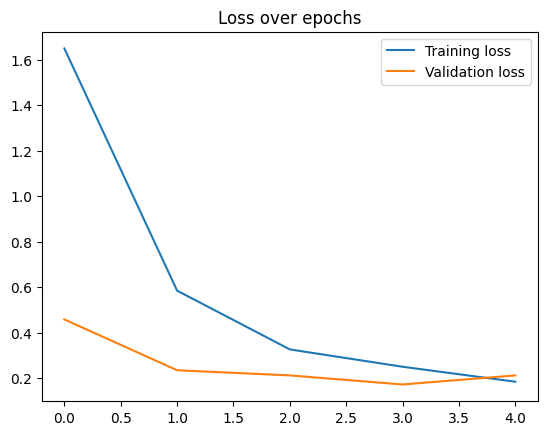

In [19]:
plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.title("Loss over epochs")
plt.show()

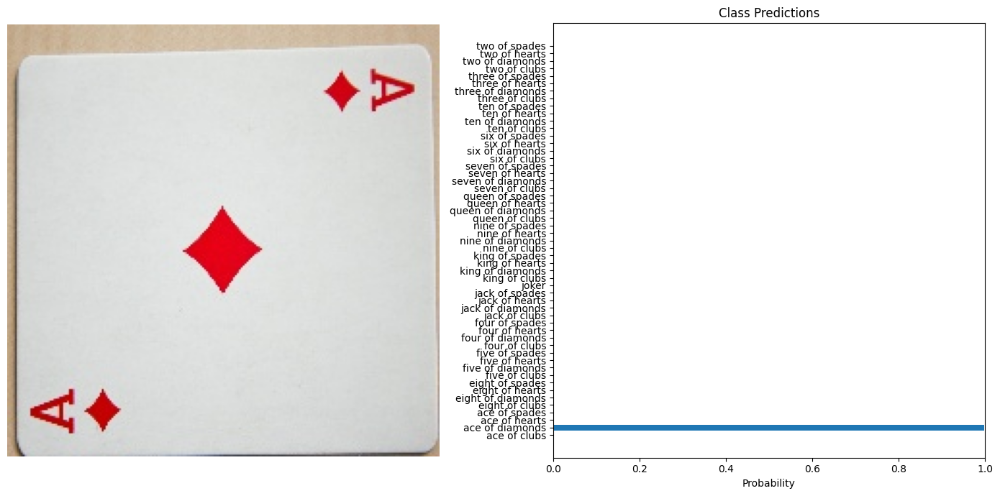

In [24]:
import torch
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

def preprocess_image(image_path, transform):
    image = Image.open(image_path).convert("RGB")
    return image, transform(image).unsqueeze(0)


def predict(model, image_tensor, device):
    model.eval()
    with torch.no_grad():
        image_tensor = image_tensor.to(device)
        outputs = model(image_tensor)
        probabilities = torch.nn.functional.softmax(outputs, dim=1)
    return probabilities.cpu().numpy().flatten()

def visualize_predictions(original_image, probabilities, class_names):
    fig, axarr = plt.subplots(1, 2, figsize=(14, 7))

    axarr[0].imshow(original_image)
    axarr[0].axis("off")


    axarr[1].barh(class_names, probabilities)
    axarr[1].set_xlabel("Probability")
    axarr[1].set_title("Class Predictions")
    axarr[1].set_xlim(0, 1)

    plt.tight_layout()
    plt.show()


test_image = "/content/drive/MyDrive/dataset_cards/train/ace of diamonds/001.jpg"
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])

original_image, image_tensor = preprocess_image(test_image, transform)
probabilities = predict(model, image_tensor, device)


class_names = ['ace of clubs', 'ace of diamonds', 'ace of hearts', 'ace of spades', 'eight of clubs', 'eight of diamonds', 'eight of hearts', 'eight of spades',
               'five of clubs', 'five of diamonds', 'five of hearts', 'five of spades', 'four of clubs', 'four of diamonds', 'four of hearts', 'four of spades',
               'jack of clubs', 'jack of diamonds', 'jack of hearts', 'jack of spades', 'joker', 'king of clubs', 'king of diamonds', 'king of hearts', 'king of spades',
               'nine of clubs', 'nine of diamonds', 'nine of hearts', 'nine of spades', 'queen of clubs', 'queen of diamonds', 'queen of hearts', 'queen of spades',
               'seven of clubs', 'seven of diamonds', 'seven of hearts', 'seven of spades', 'six of clubs', 'six of diamonds', 'six of hearts', 'six of spades',
               'ten of clubs', 'ten of diamonds', 'ten of hearts', 'ten of spades', 'three of clubs', 'three of diamonds', 'three of hearts', 'three of spades',
               'two of clubs', 'two of diamonds', 'two of hearts', 'two of spades']

visualize_predictions(original_image, probabilities, class_names)


In [25]:

model_save_path = "card_classifier.pth"
torch.save(model.state_dict(), model_save_path)
print(f"Model saved at {model_save_path}")


Model saved at card_classifier.pth


# Using the model to Predict

In [27]:
import torch
import timm
import torch.nn as nn


class CardClassifier(nn.Module):
    def __init__(self, num_classes=53):
        super(CardClassifier, self).__init__()
        self.base_model = timm.create_model('efficientnet_b0', pretrained=True)
        self.features = nn.Sequential(*list(self.base_model.children())[:-1])
        enet_out_size = 1280  # Output size of EfficientNet-B0
        self.classifier = nn.Linear(enet_out_size, num_classes)

    def forward(self, x):
        x = self.features(x)
        x = torch.flatten(x, 1)
        output = self.classifier(x)
        return output


model = CardClassifier(num_classes=53)


model.load_state_dict(torch.load('card_classifier.pth'))


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)


model.eval()


<ipython-input-27-000b72e955d2>:24: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('card_classifier.pth'))


CardClassifier(
  (base_model): EfficientNet(
    (conv_stem): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNormAct2d(
      32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
      (drop): Identity()
      (act): SiLU(inplace=True)
    )
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn1): BatchNormAct2d(
            32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
            (act): SiLU(inplace=True)
          )
          (aa): Identity()
          (se): SqueezeExcite(
            (conv_reduce): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (act1): SiLU(inplace=True)
            (conv_expand): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (gate): Sigmoid()
          )
          (conv_p

In [31]:
import torch
from PIL import Image
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt

# Function to preprocess the image
def preprocess_image(image_path, transform):
    image = Image.open(image_path).convert("RGB")  # Open and convert image to RGB
    return image, transform(image).unsqueeze(0)  # Apply transform and add batch dimension

# Function to make a prediction
def predict(model, image_tensor, device):
    model.eval()  # Set model to evaluation mode
    with torch.no_grad():  # Turn off gradient tracking for inference
        image_tensor = image_tensor.to(device)  # Move image tensor to the appropriate device
        outputs = model(image_tensor)  # Get model's raw outputs
        probabilities = torch.nn.functional.softmax(outputs, dim=1)  # Convert logits to probabilities
    return probabilities.cpu().numpy().flatten()  # Return the probabilities as a numpy array

# Example usage
test_image = "/content/drive/MyDrive/dataset_cards/train/ace of diamonds/"  # Replace with the path to your test image
transform = transforms.Compose([
    transforms.Resize((128, 128)),  # Resize image to match the input size used during training
    transforms.ToTensor(),          # Convert image to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize with standard values
])

# Preprocess the image
original_image, image_tensor = preprocess_image(test_image, transform)

# Predict the class
probabilities = predict(model, image_tensor, device)

# Assuming class_names is a dictionary of your card classes
class_names = {0: 'ace of clubs', 1: 'ace of diamonds', 2: 'ace of hearts', 3: 'ace of spades', 4: 'eight of clubs', 5: 'eight of diamonds', 6: 'eight of hearts', 7: 'eight of spades', 8: 'five of clubs', 9: 'five of diamonds', 10: 'five of hearts', 11: 'five of spades', 12: 'four of clubs', 13: 'four of diamonds', 14: 'four of hearts', 15: 'four of spades', 16: 'jack of clubs', 17: 'jack of diamonds', 18: 'jack of hearts', 19: 'jack of spades', 20: 'joker', 21: 'king of clubs', 22: 'king of diamonds', 23: 'king of hearts', 24: 'king of spades', 25: 'nine of clubs', 26: 'nine of diamonds', 27: 'nine of hearts', 28: 'nine of spades', 29: 'queen of clubs', 30: 'queen of diamonds', 31: 'queen of hearts', 32: 'queen of spades', 33: 'seven of clubs', 34: 'seven of diamonds', 35: 'seven of hearts', 36: 'seven of spades', 37: 'six of clubs', 38: 'six of diamonds', 39: 'six of hearts', 40: 'six of spades', 41: 'ten of clubs', 42: 'ten of diamonds', 43: 'ten of hearts', 44: 'ten of spades', 45: 'three of clubs', 46: 'three of diamonds', 47: 'three of hearts', 48: 'three of spades', 49: 'two of clubs', 50: 'two of diamonds', 51: 'two of hearts', 52: 'two of spades'}  # Add all class names
predicted_class_index = np.argmax(probabilities)
predicted_class_name = class_names[predicted_class_index]

# Print the predicted class
print(f"Predicted Card: {predicted_class_name}")

# Visualize the image and prediction
def visualize_predictions(original_image, probabilities, class_names):
    fig, axarr = plt.subplots(1, 2, figsize=(14, 7))

    # Display the image
    axarr[0].imshow(original_image)
    axarr[0].axis("off")

    # Display the prediction bar chart
    axarr[1].barh(list(class_names.values()), probabilities)
    axarr[1].set_xlabel("Probability")
    axarr[1].set_title("Class Predictions")
    axarr[1].set_xlim(0, 1)

    plt.tight_layout()
    plt.show()

# Visualize the result
visualize_predictions(original_image, probabilities, class_names)


IsADirectoryError: [Errno 21] Is a directory: '/content/drive/MyDrive/dataset_cards/train/ace of diamonds'

<ipython-input-33-0acaf9925ff3>:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('card_classifier.pth'))  # Load the trained model
Processi

Image: 120.jpg - Predicted Card: six of diamonds


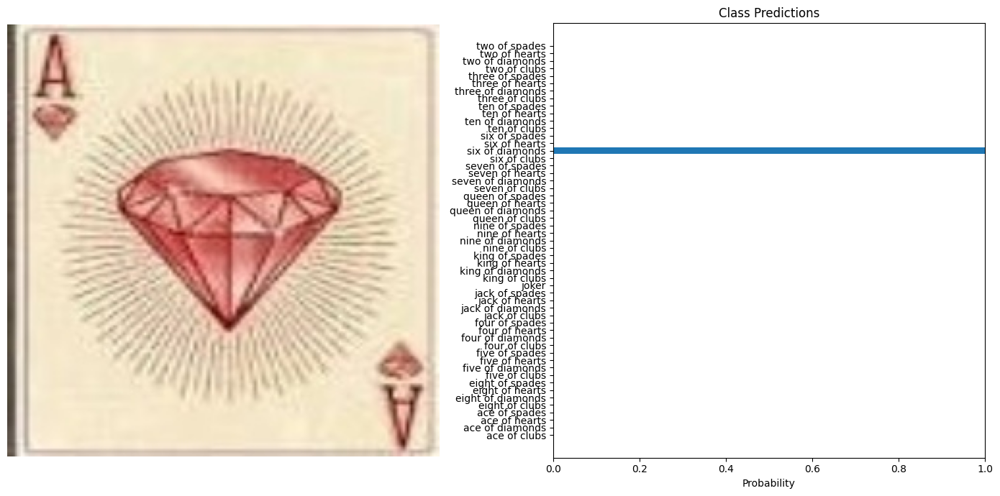

Processing images:   1%|          | 1/129 [00:00<01:37,  1.32it/s]

Image: 093.jpg - Predicted Card: king of diamonds


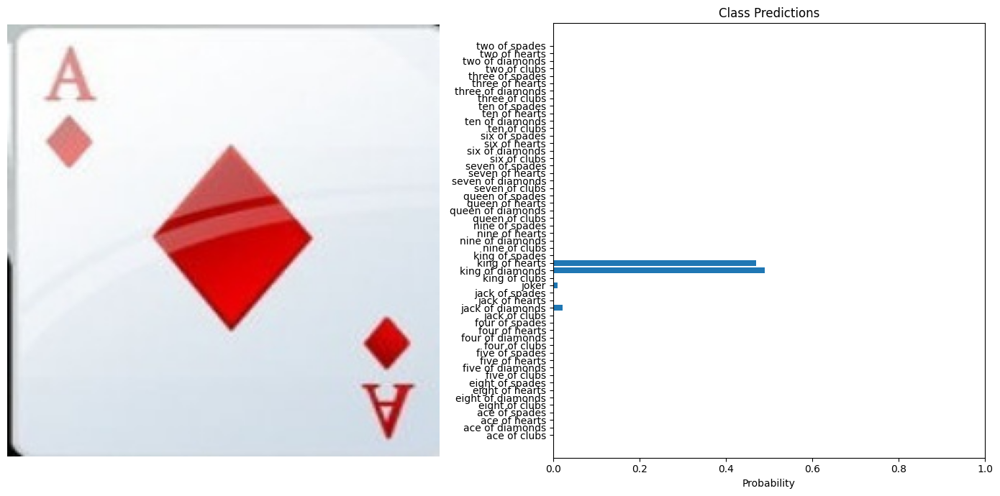

Processing images:   2%|▏         | 2/129 [00:01<01:43,  1.23it/s]

Image: 118.jpg - Predicted Card: jack of diamonds


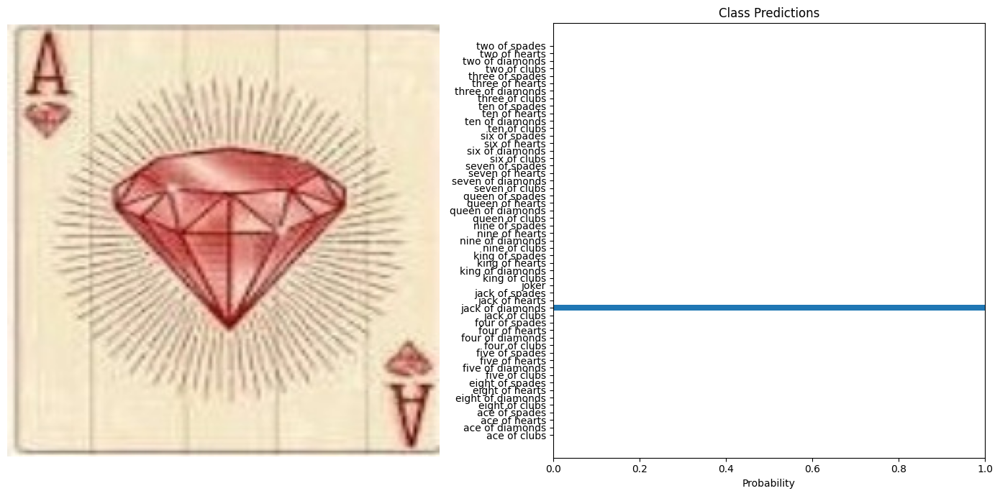

Processing images:   2%|▏         | 3/129 [00:02<01:40,  1.25it/s]

Image: 109.jpg - Predicted Card: ten of diamonds


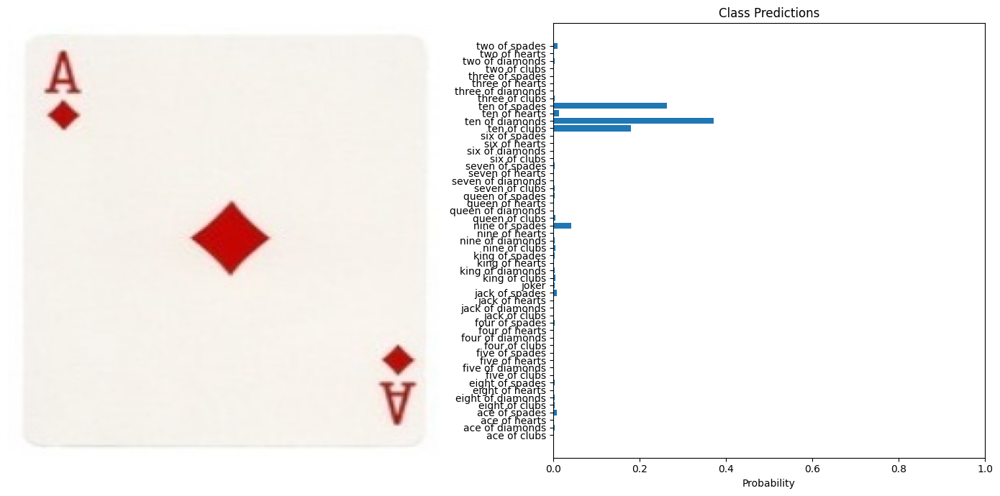

Processing images:   3%|▎         | 4/129 [00:03<01:49,  1.15it/s]

Image: 089.jpg - Predicted Card: nine of spades


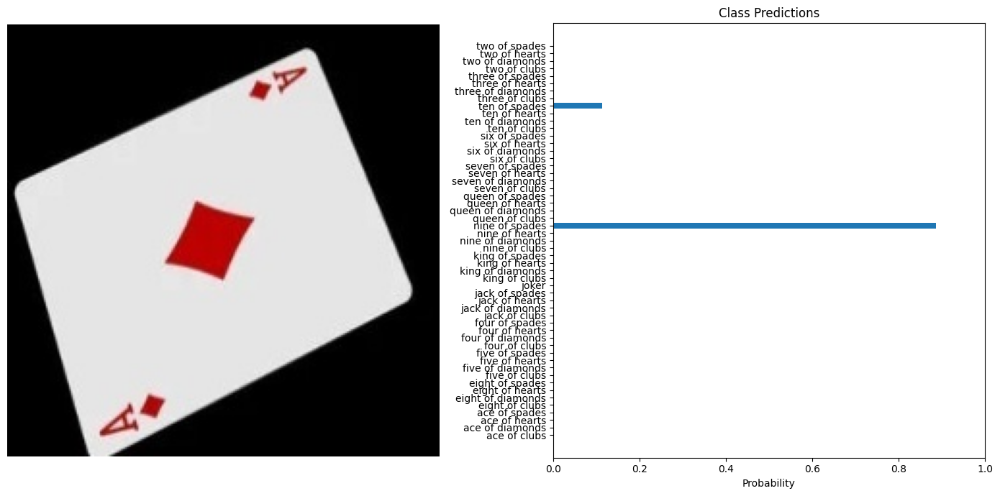

Processing images:   4%|▍         | 5/129 [00:04<01:39,  1.25it/s]

Image: 005.jpg - Predicted Card: four of spades


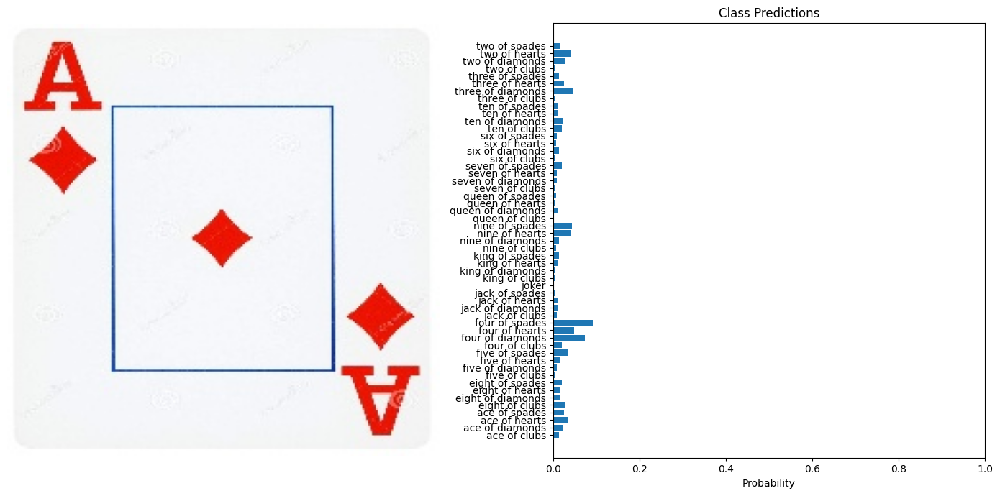

Processing images:   5%|▍         | 6/129 [00:04<01:35,  1.28it/s]

Image: 012.jpg - Predicted Card: five of clubs


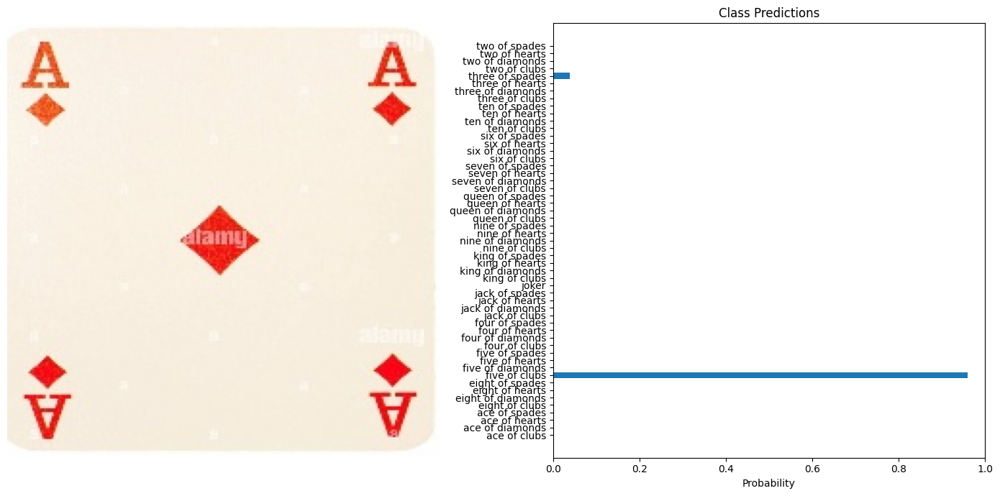

Processing images:   5%|▌         | 7/129 [00:05<01:35,  1.28it/s]

Image: 037.jpg - Predicted Card: queen of hearts


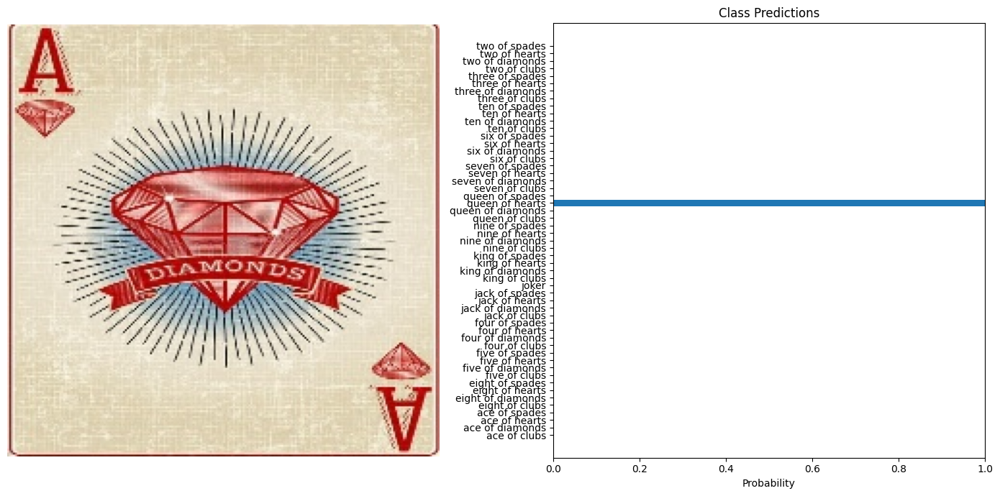

Processing images:   6%|▌         | 8/129 [00:06<01:47,  1.13it/s]

Image: 002.jpg - Predicted Card: three of hearts


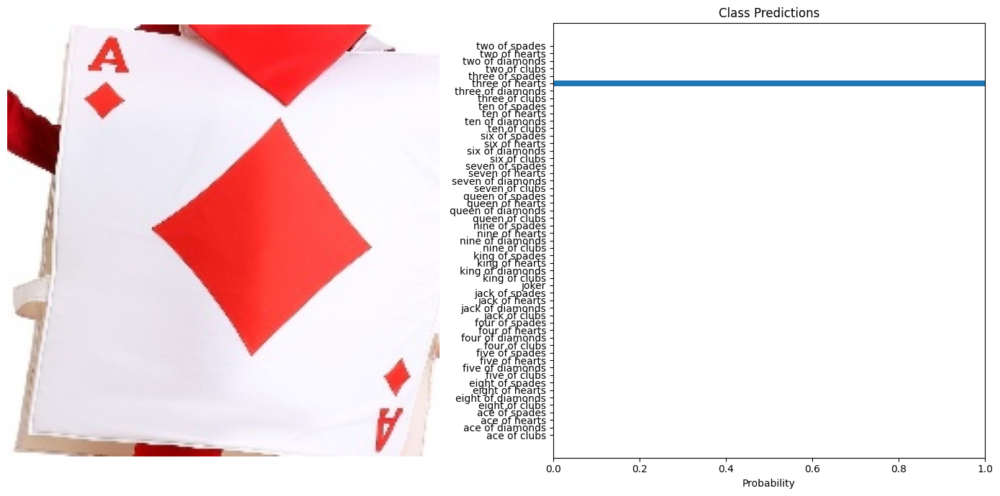

Processing images:   7%|▋         | 9/129 [00:07<01:54,  1.05it/s]

Image: 025.jpg - Predicted Card: six of clubs


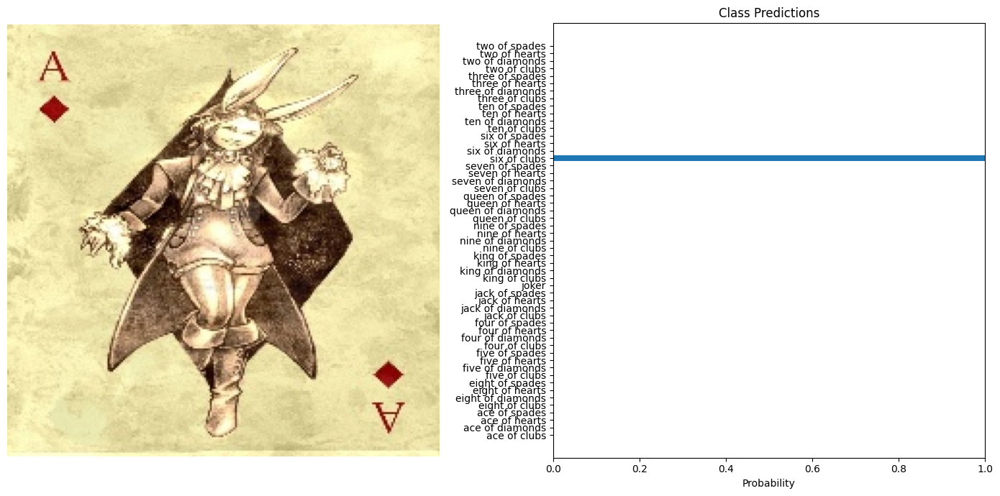

Processing images:   8%|▊         | 10/129 [00:08<02:00,  1.02s/it]

Image: 010.jpg - Predicted Card: ten of diamonds


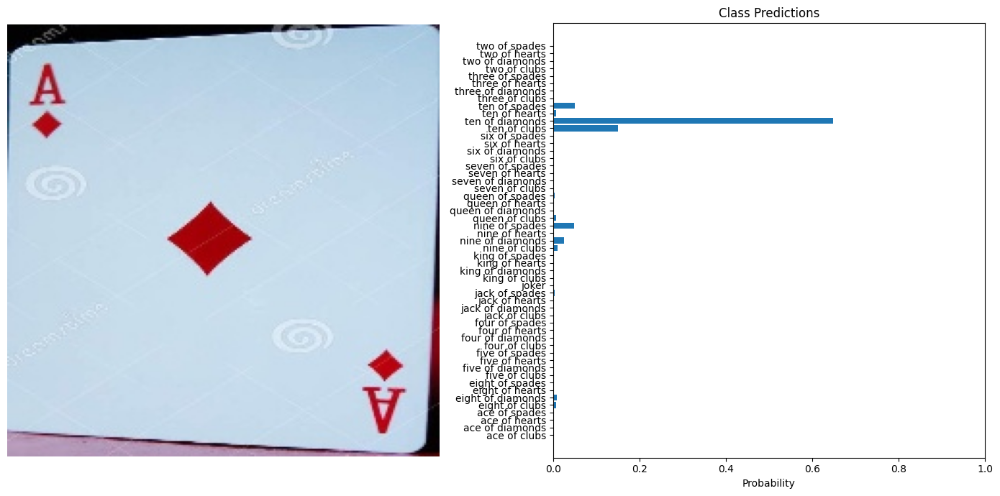

Processing images:   9%|▊         | 11/129 [00:10<02:06,  1.07s/it]

Image: 123.jpg - Predicted Card: four of spades


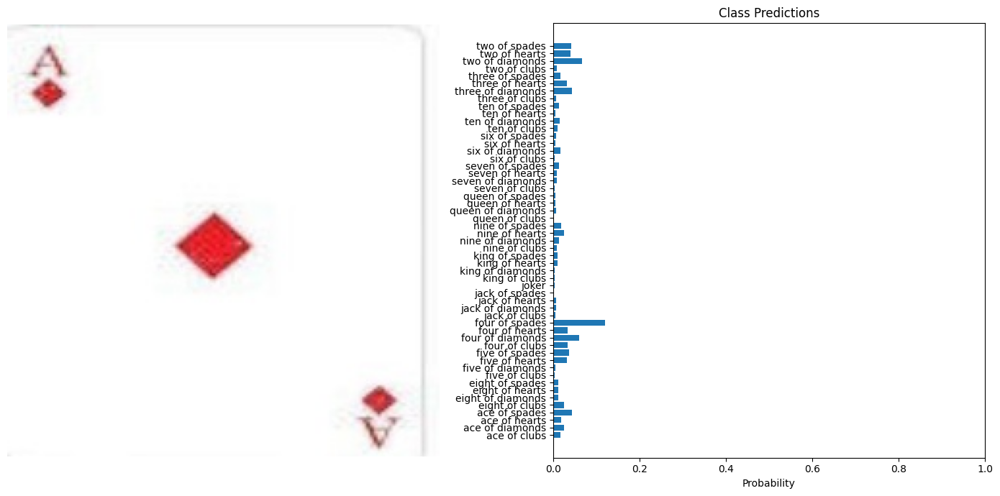

Processing images:   9%|▉         | 12/129 [00:10<01:57,  1.01s/it]

Image: 076.jpg - Predicted Card: two of diamonds


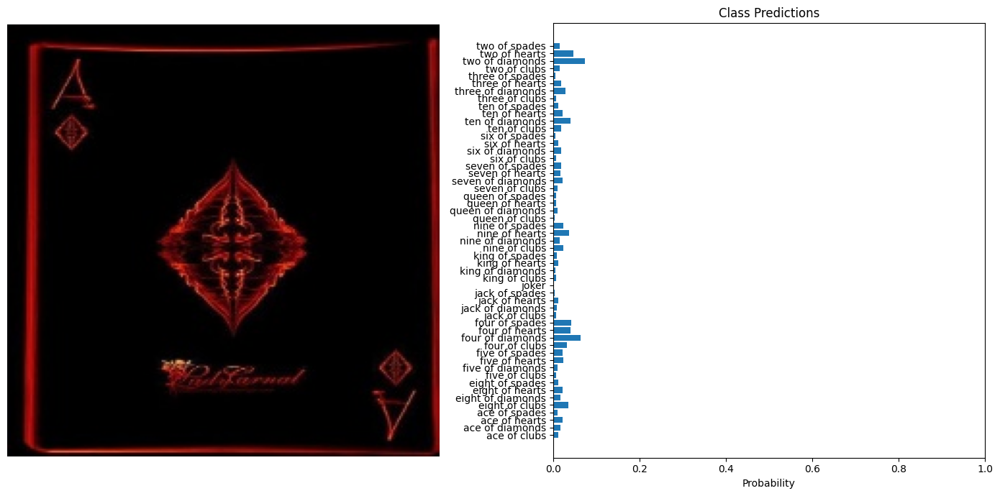

Processing images:  10%|█         | 13/129 [00:11<01:55,  1.00it/s]

Image: 107.jpg - Predicted Card: eight of diamonds


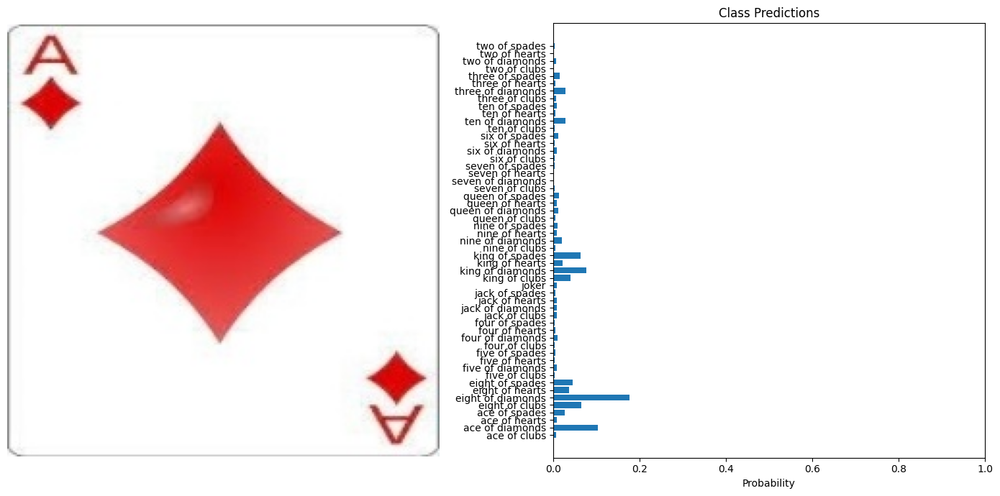

Processing images:  11%|█         | 14/129 [00:12<01:47,  1.07it/s]

Image: 070.jpg - Predicted Card: ten of diamonds


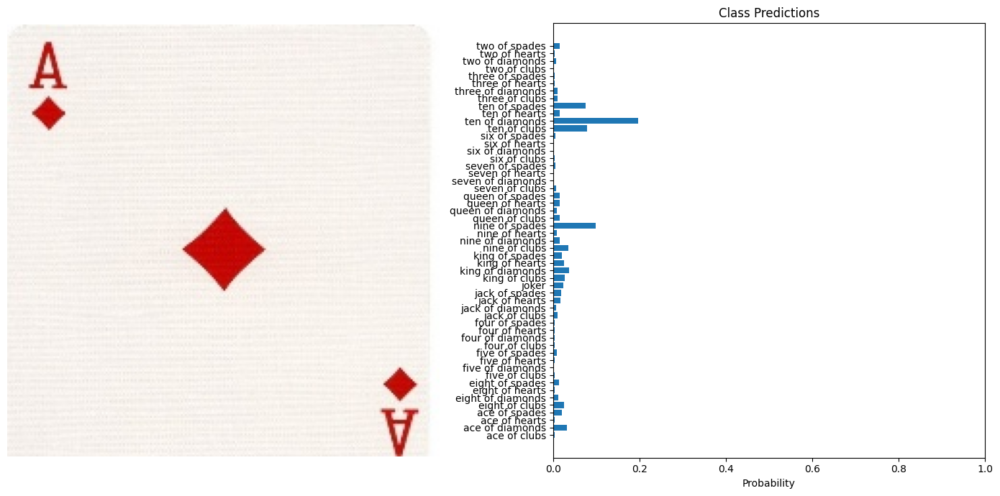

Processing images:  12%|█▏        | 15/129 [00:13<01:42,  1.11it/s]

Image: 030.jpg - Predicted Card: four of diamonds


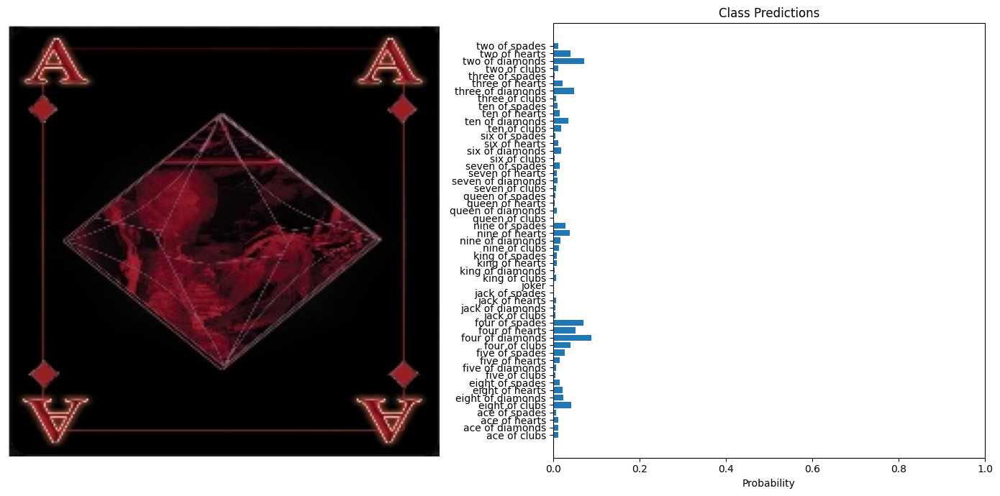

Processing images:  12%|█▏        | 16/129 [00:14<01:37,  1.16it/s]

Image: 065.jpg - Predicted Card: ten of diamonds


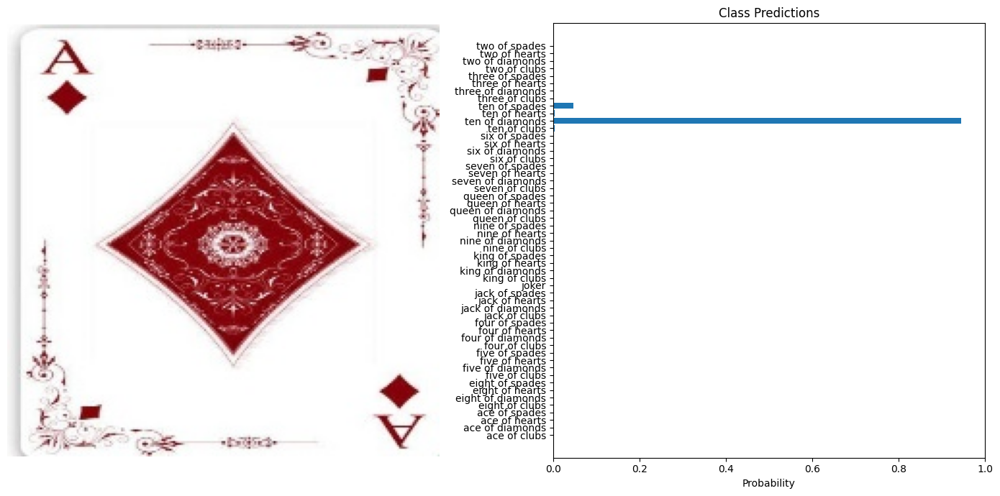

Processing images:  13%|█▎        | 17/129 [00:15<01:35,  1.18it/s]

Image: 112.jpg - Predicted Card: five of clubs


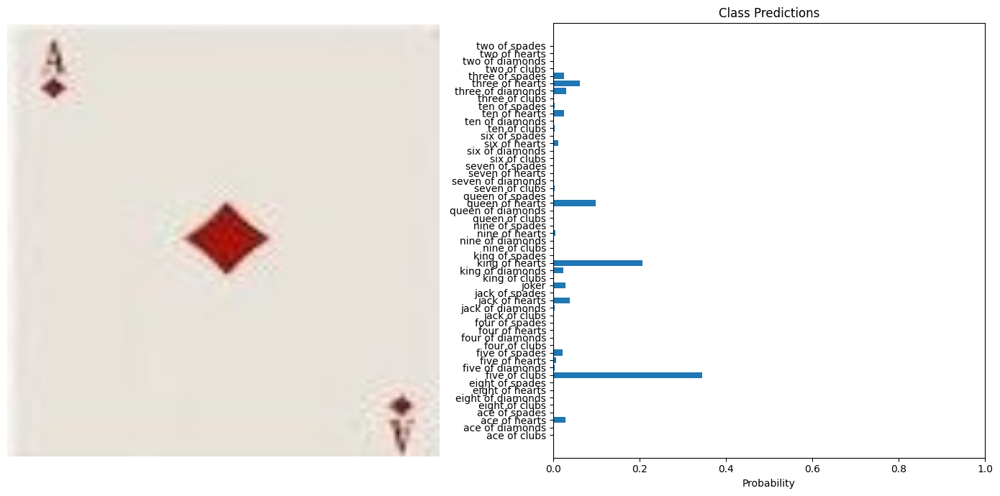

Processing images:  14%|█▍        | 18/129 [00:15<01:32,  1.20it/s]

Image: 015.jpg - Predicted Card: ace of spades


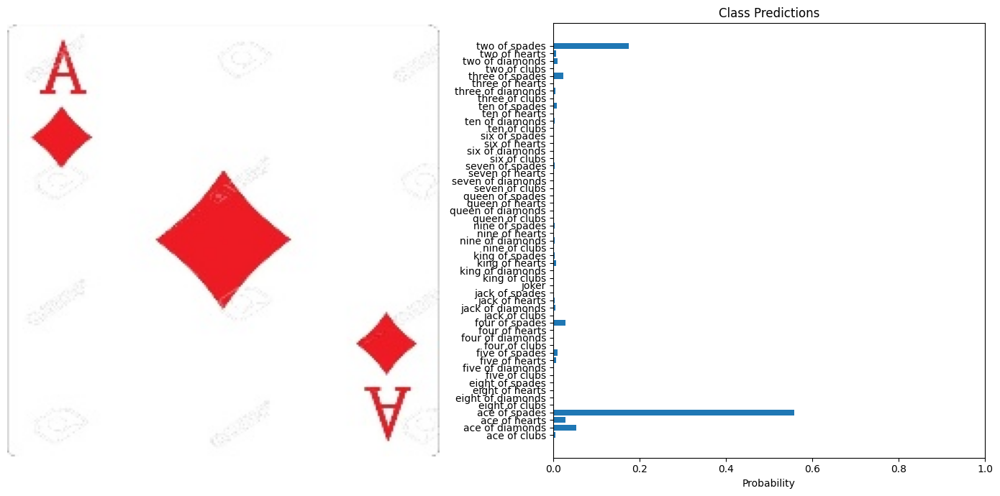

Processing images:  15%|█▍        | 19/129 [00:16<01:30,  1.22it/s]

Image: 106.jpg - Predicted Card: four of spades


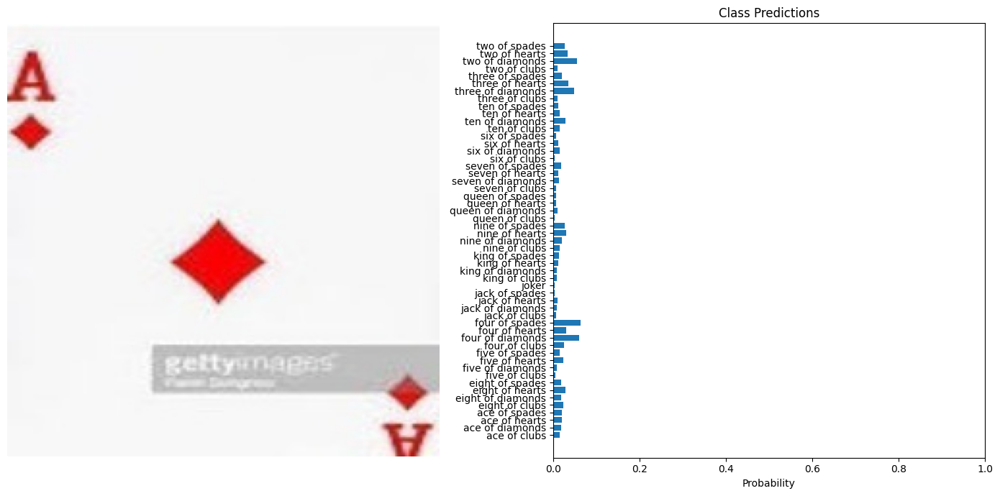

Processing images:  16%|█▌        | 20/129 [00:17<01:28,  1.22it/s]

Image: 111.jpg - Predicted Card: four of spades


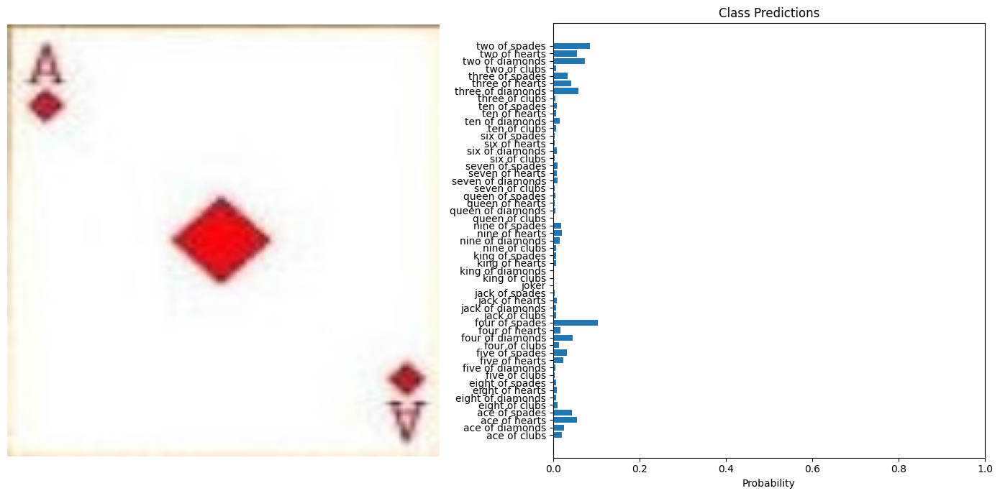

Processing images:  16%|█▋        | 21/129 [00:18<01:27,  1.23it/s]

Image: 006.jpg - Predicted Card: ace of diamonds


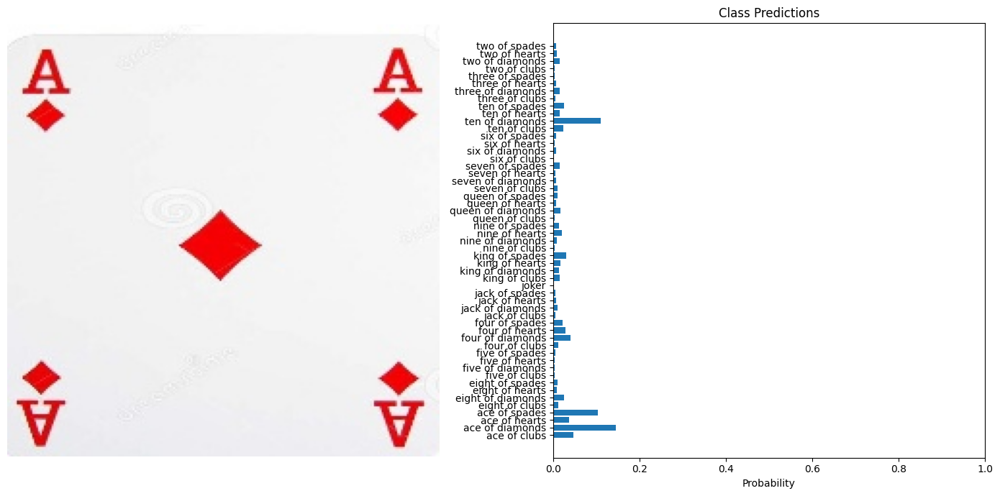

Processing images:  17%|█▋        | 22/129 [00:19<01:36,  1.10it/s]

Image: 063.jpg - Predicted Card: joker


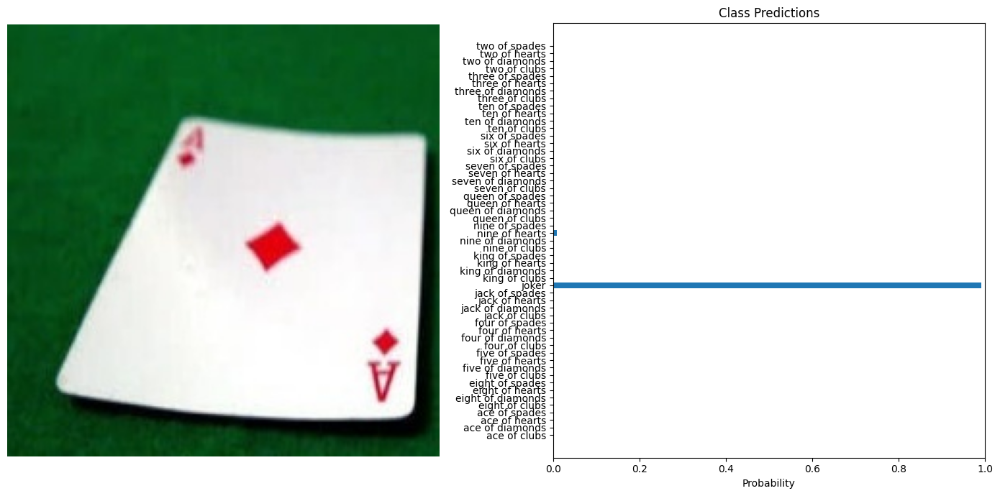

Processing images:  18%|█▊        | 23/129 [00:20<01:35,  1.11it/s]

Image: 040.jpg - Predicted Card: seven of diamonds


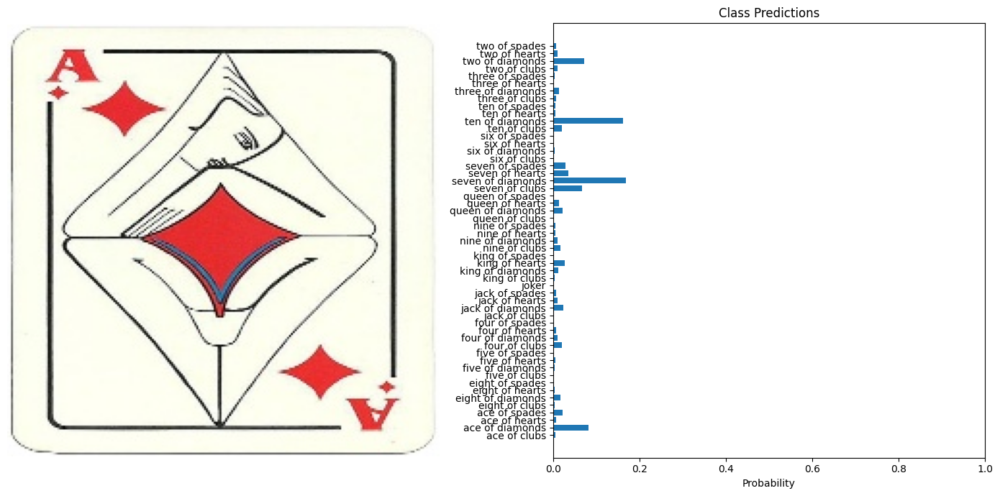

Processing images:  19%|█▊        | 24/129 [00:21<01:41,  1.03it/s]

Image: 104.jpg - Predicted Card: queen of hearts


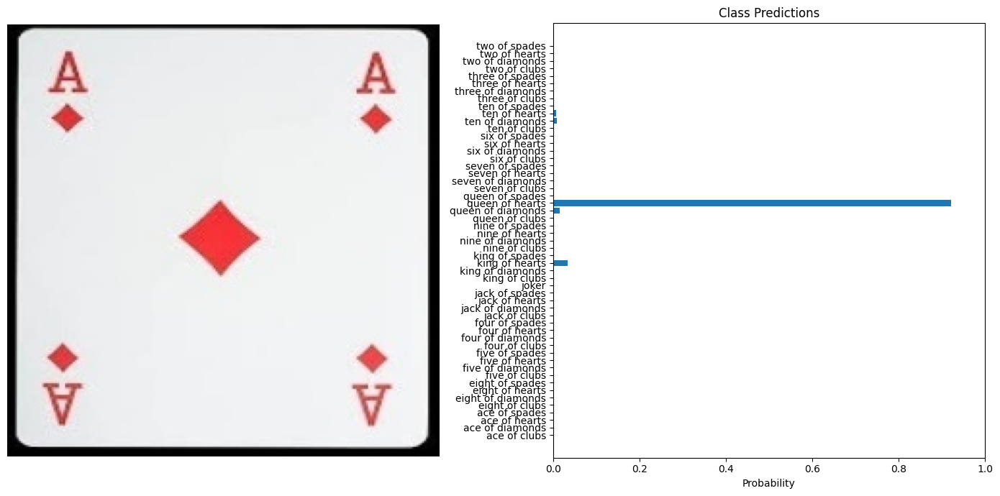

Processing images:  19%|█▉        | 25/129 [00:22<01:46,  1.02s/it]

Image: 057.jpg - Predicted Card: two of spades


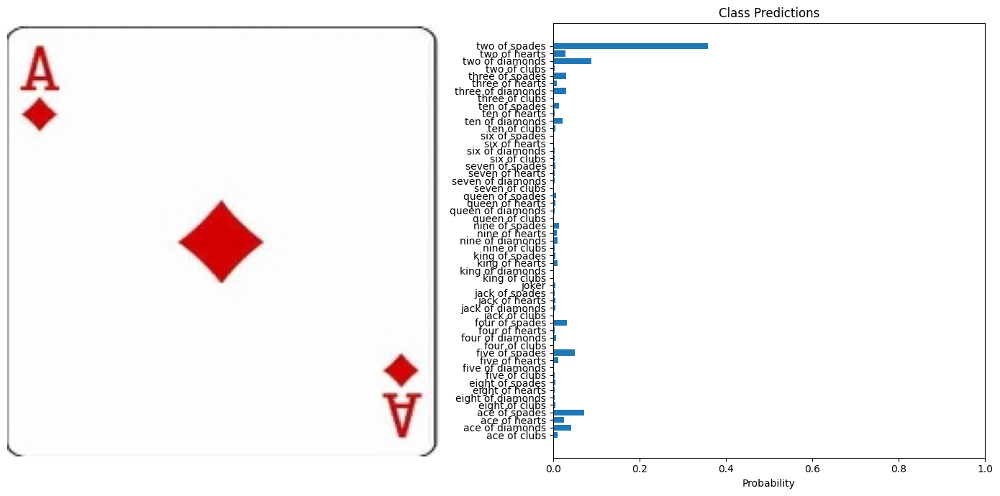

Processing images:  20%|██        | 26/129 [00:23<01:47,  1.05s/it]

Image: 001.jpg - Predicted Card: six of diamonds


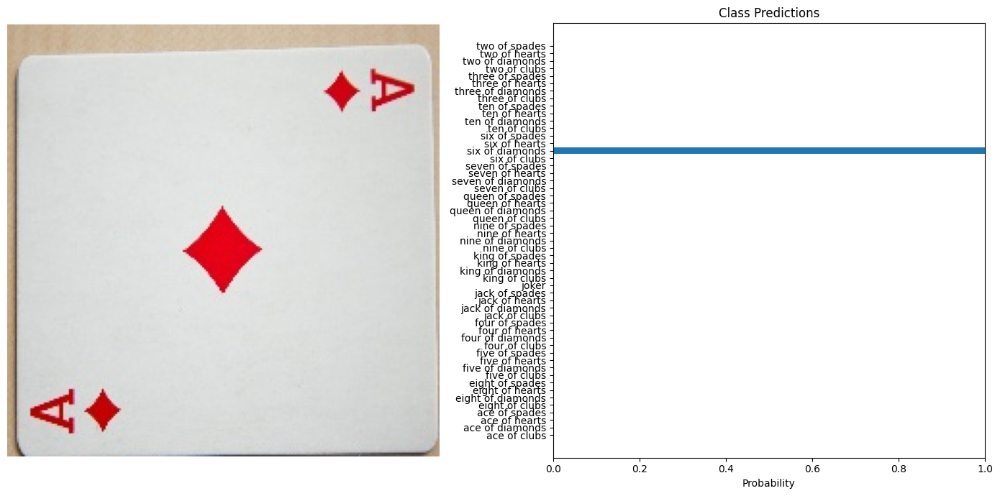

Processing images:  21%|██        | 27/129 [00:24<01:50,  1.08s/it]

Image: 003.jpg - Predicted Card: two of hearts


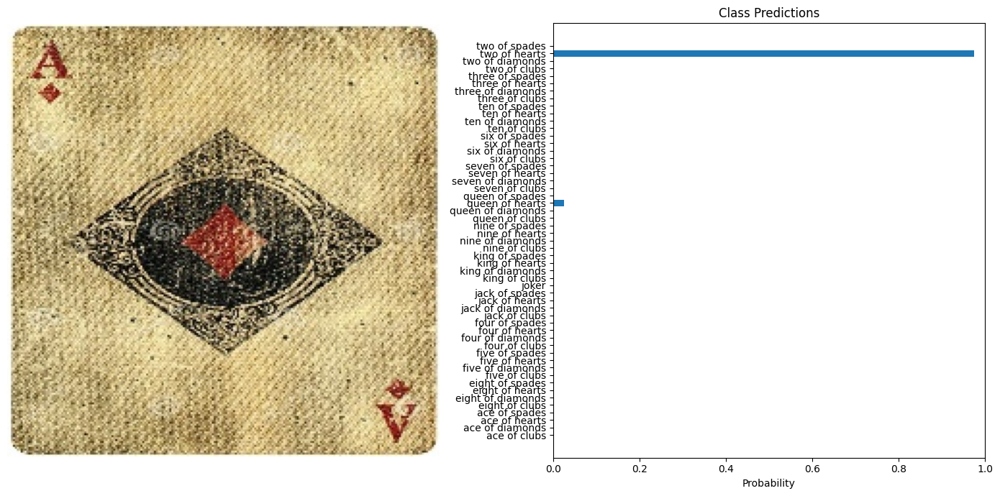

Processing images:  22%|██▏       | 28/129 [00:26<01:57,  1.16s/it]

Image: 073.jpg - Predicted Card: ten of diamonds


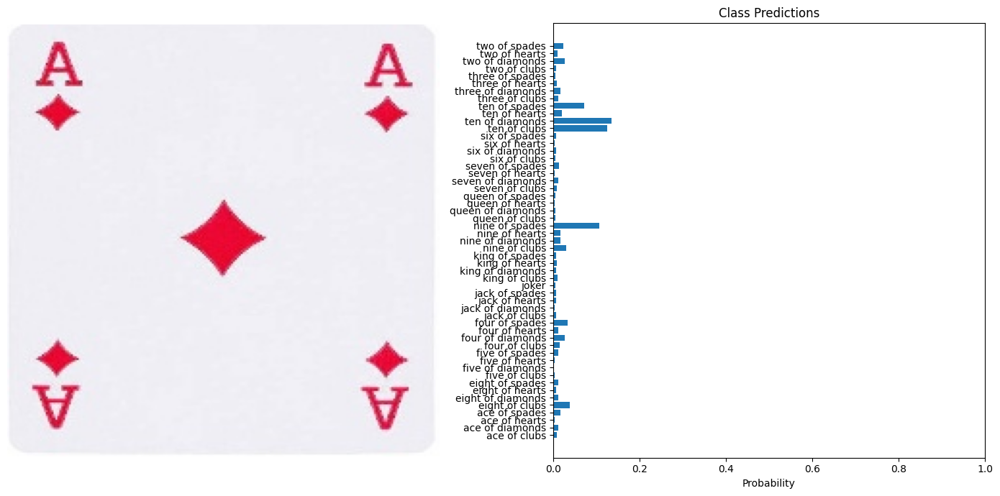

Processing images:  22%|██▏       | 29/129 [00:27<01:49,  1.09s/it]

Image: 041.jpg - Predicted Card: king of hearts


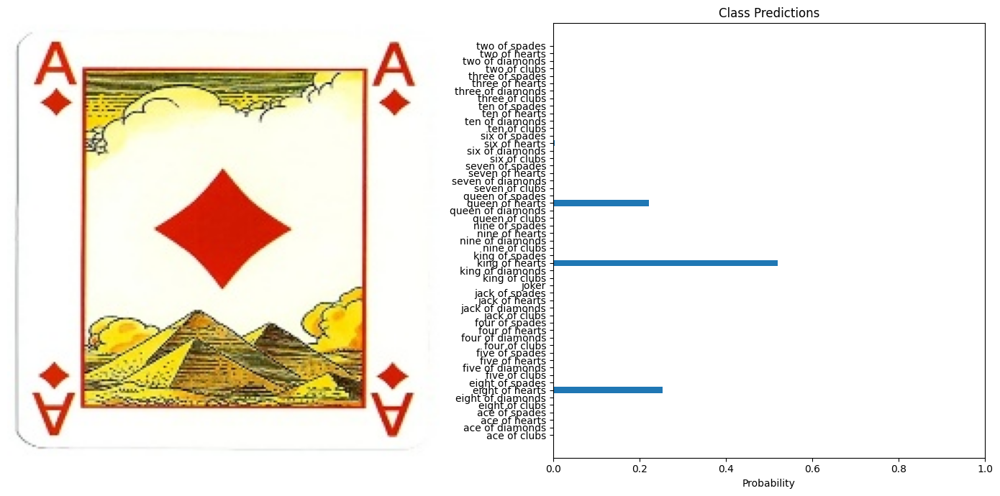

Processing images:  23%|██▎       | 30/129 [00:28<01:42,  1.03s/it]

Image: 087.jpg - Predicted Card: three of diamonds


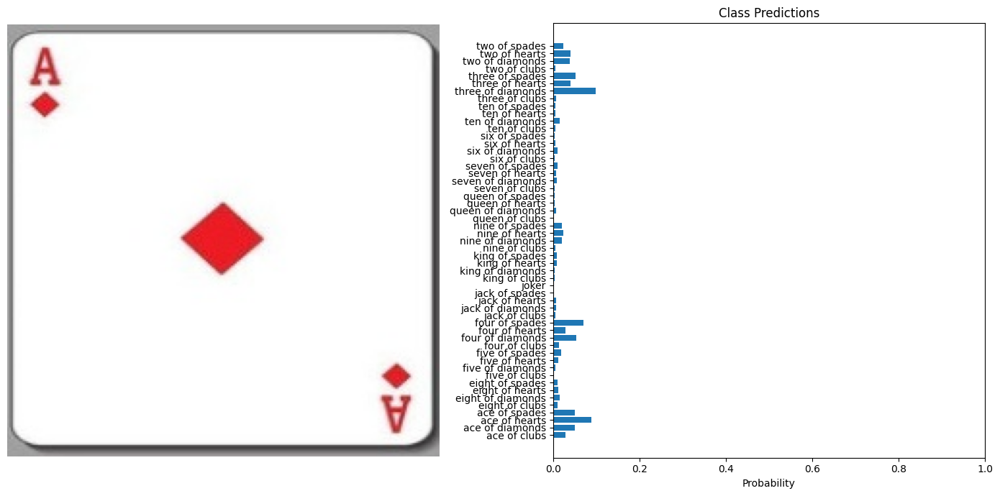

Processing images:  24%|██▍       | 31/129 [00:28<01:36,  1.01it/s]

Image: 068.jpg - Predicted Card: ace of spades


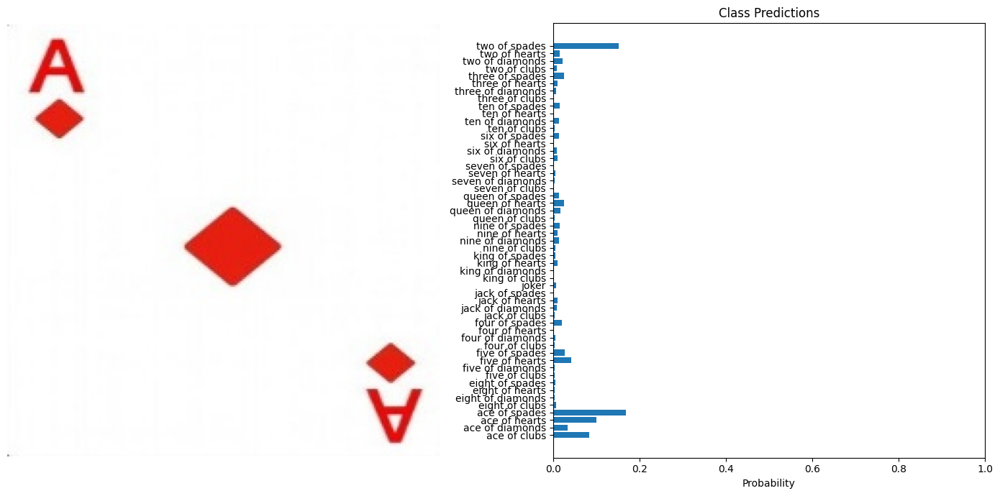

Processing images:  25%|██▍       | 32/129 [00:30<01:37,  1.01s/it]

Image: 085.jpg - Predicted Card: queen of hearts


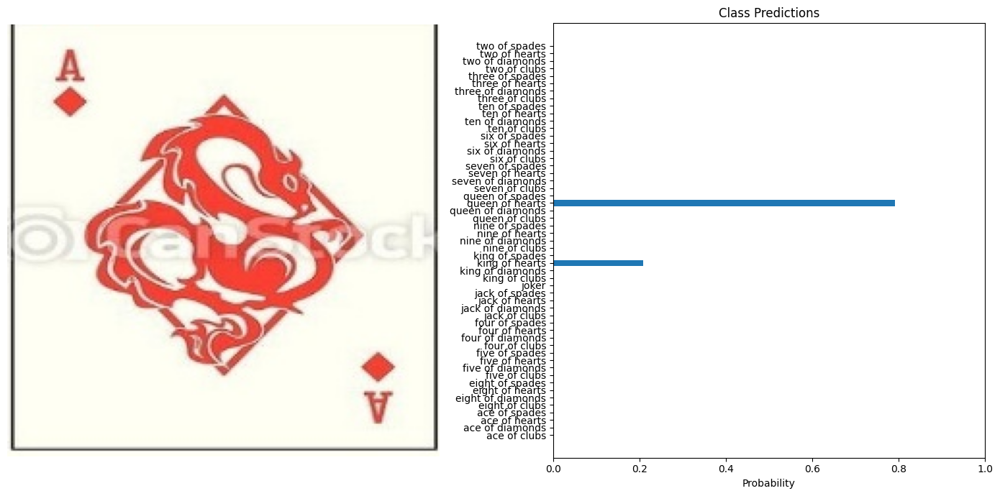

Processing images:  26%|██▌       | 33/129 [00:30<01:33,  1.02it/s]

Image: 043.jpg - Predicted Card: four of spades


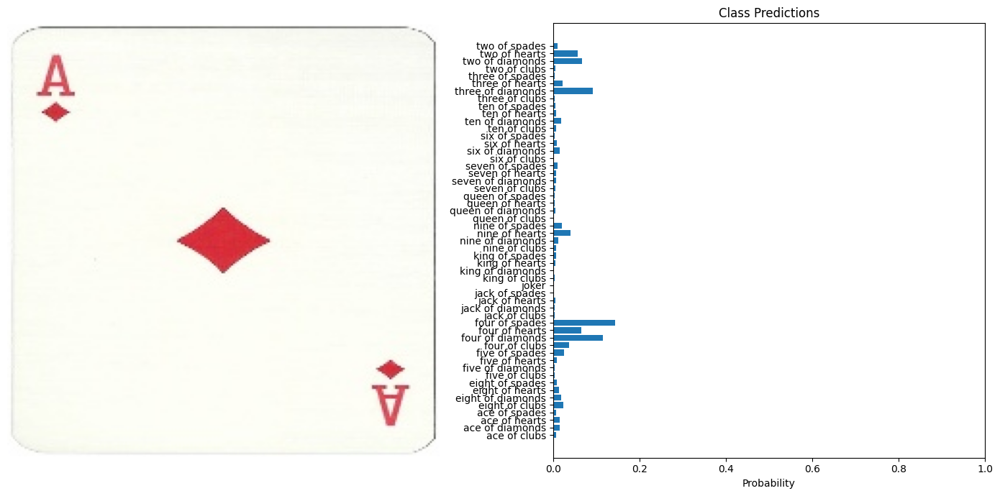

Processing images:  26%|██▋       | 34/129 [00:31<01:31,  1.04it/s]

Image: 064.jpg - Predicted Card: queen of spades


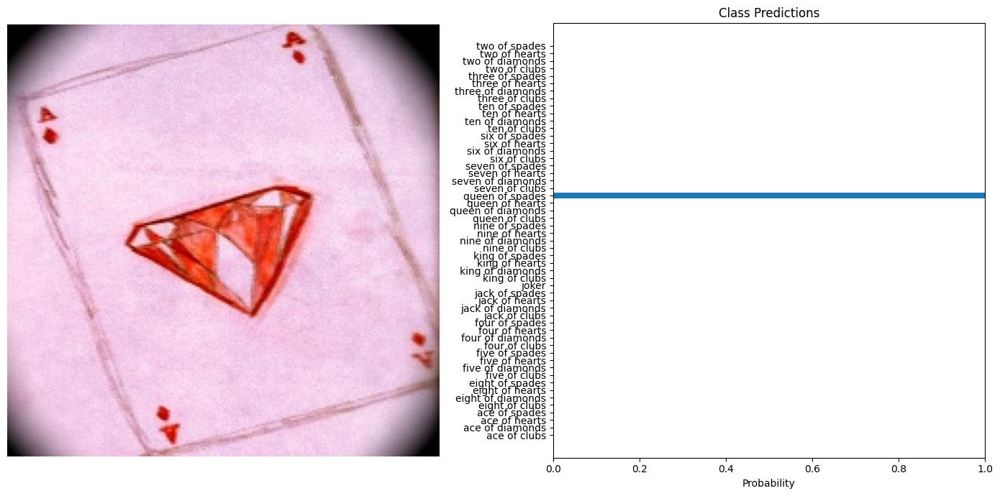

Processing images:  27%|██▋       | 35/129 [00:32<01:32,  1.02it/s]

Image: 018.jpg - Predicted Card: queen of hearts


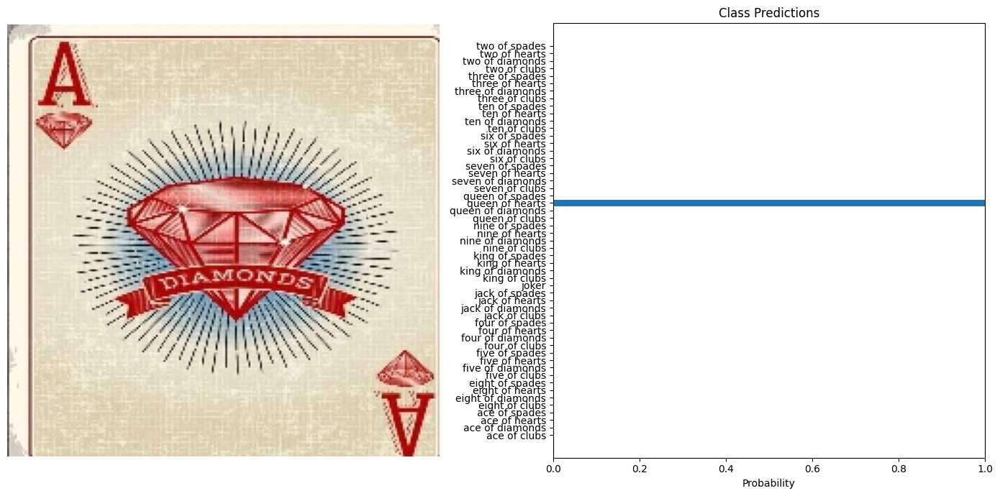

Processing images:  28%|██▊       | 36/129 [00:33<01:32,  1.01it/s]

Image: 094.jpg - Predicted Card: queen of clubs


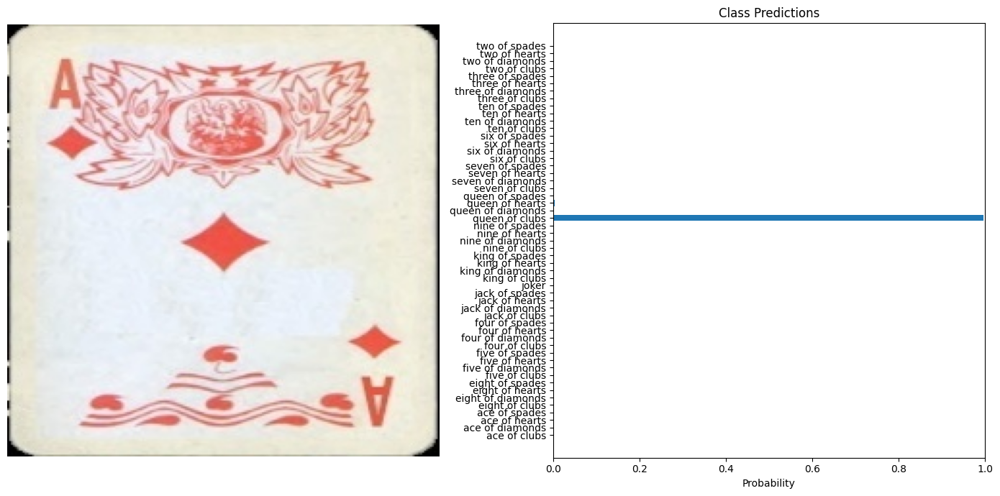

Processing images:  29%|██▊       | 37/129 [00:34<01:32,  1.01s/it]

Image: 129.jpg - Predicted Card: ten of hearts


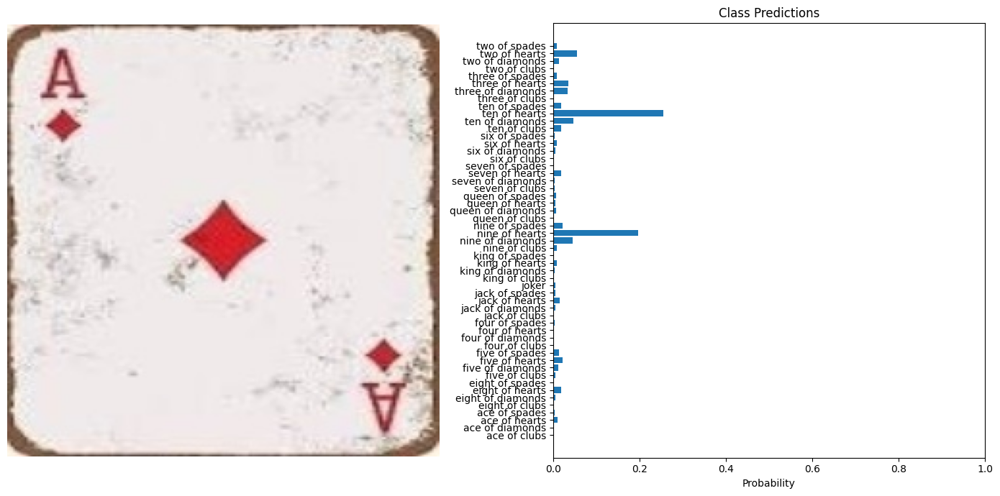

Processing images:  29%|██▉       | 38/129 [00:36<01:32,  1.02s/it]

Image: 032.jpg - Predicted Card: queen of spades


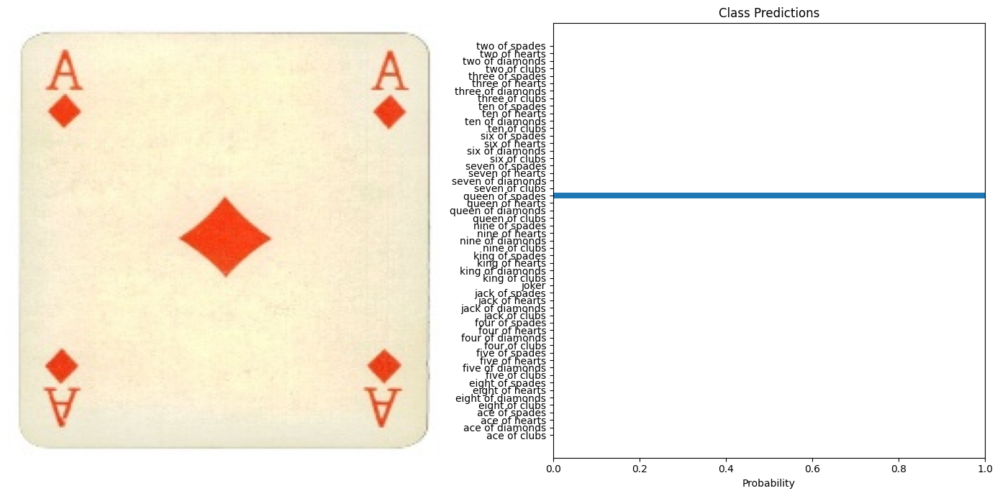

Processing images:  30%|███       | 39/129 [00:37<01:37,  1.08s/it]

Image: 075.jpg - Predicted Card: ten of diamonds


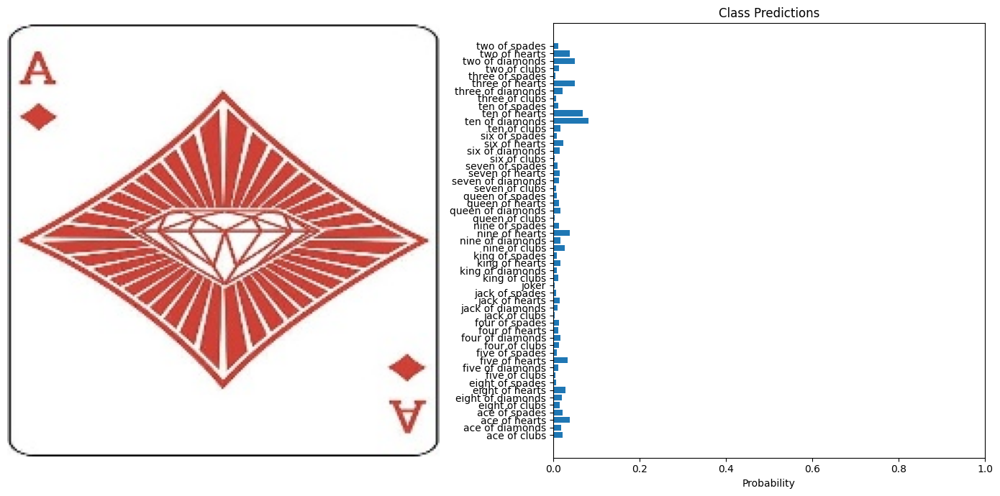

Processing images:  31%|███       | 40/129 [00:38<01:36,  1.08s/it]

Image: 029.jpg - Predicted Card: two of spades


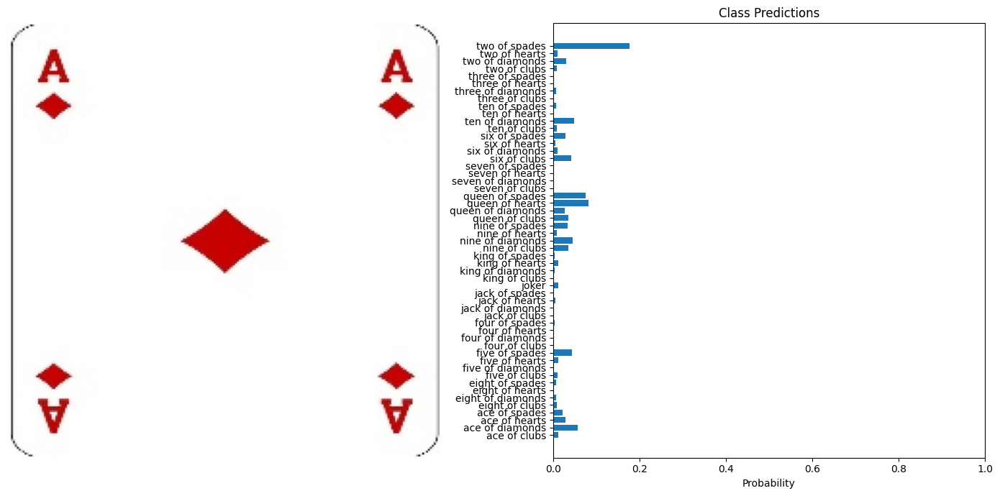

Processing images:  32%|███▏      | 41/129 [00:39<01:45,  1.20s/it]

Image: 125.jpg - Predicted Card: six of clubs


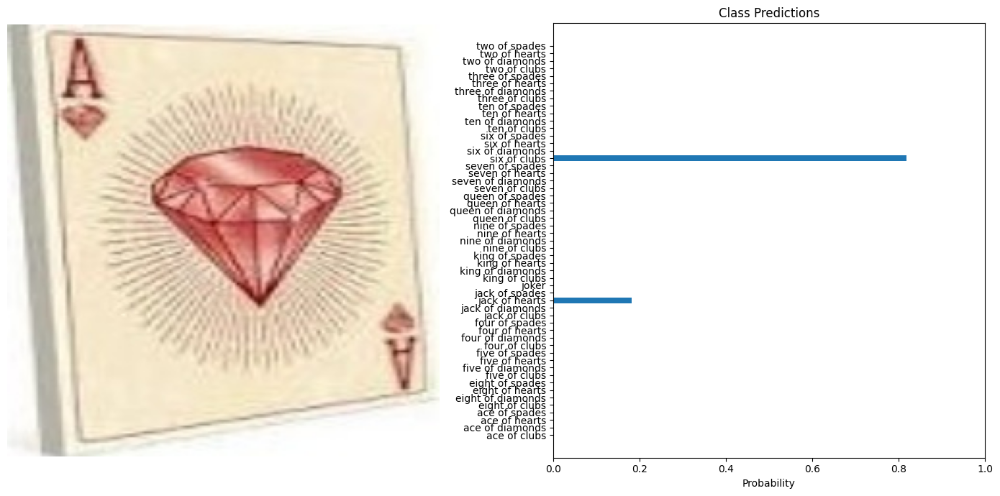

Processing images:  33%|███▎      | 42/129 [00:41<01:48,  1.24s/it]

Image: 114.jpg - Predicted Card: four of diamonds


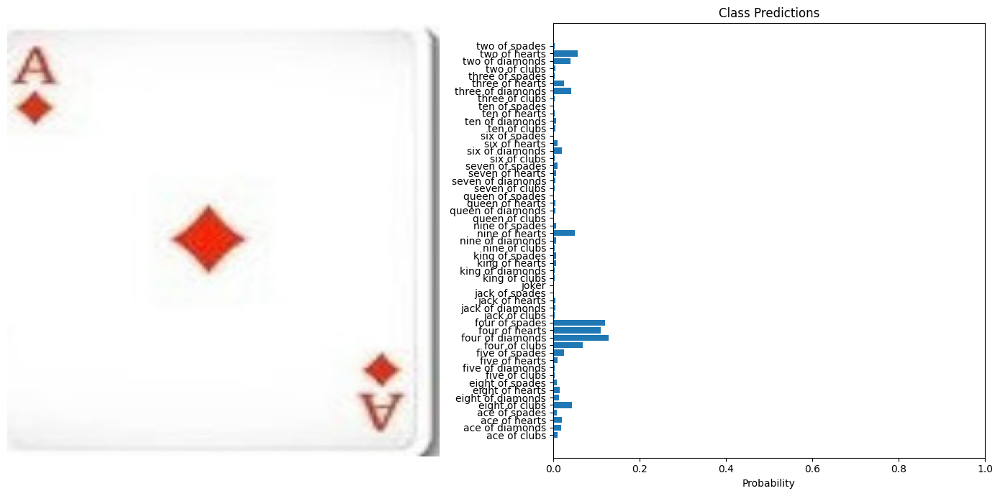

Processing images:  33%|███▎      | 43/129 [00:42<01:46,  1.23s/it]

Image: 047.jpg - Predicted Card: three of diamonds


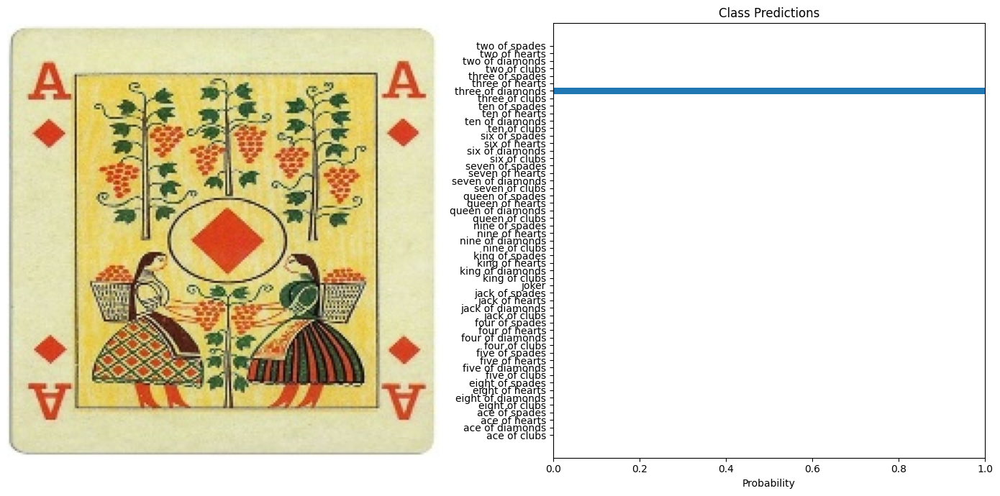

Processing images:  34%|███▍      | 44/129 [00:43<01:46,  1.25s/it]

Image: 008.jpg - Predicted Card: ace of spades


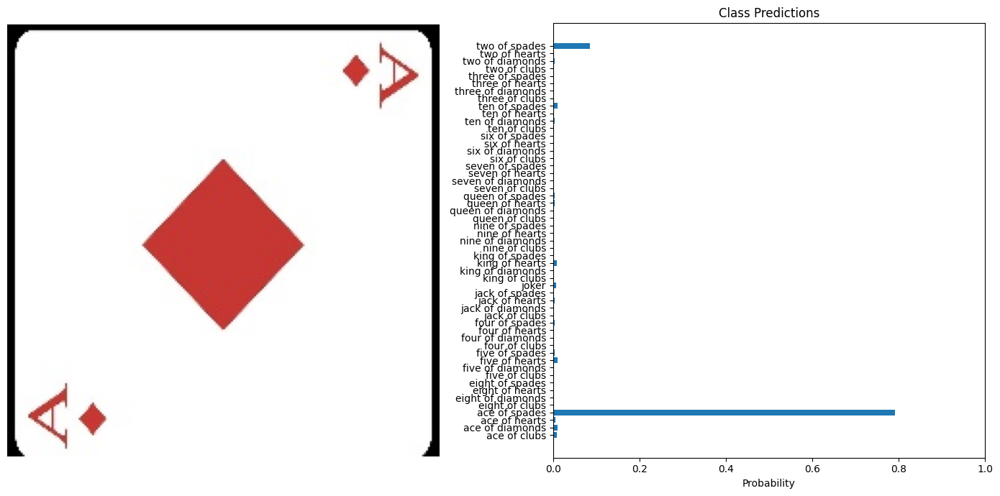

Processing images:  35%|███▍      | 45/129 [00:44<01:39,  1.18s/it]

Image: 113.jpg - Predicted Card: three of diamonds


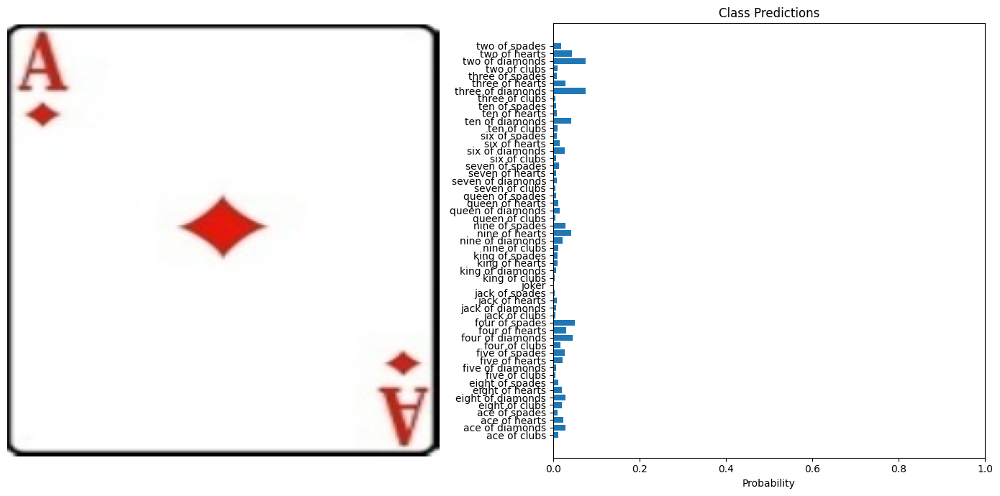

Processing images:  36%|███▌      | 46/129 [00:45<01:34,  1.13s/it]

Image: 056.jpg - Predicted Card: nine of clubs


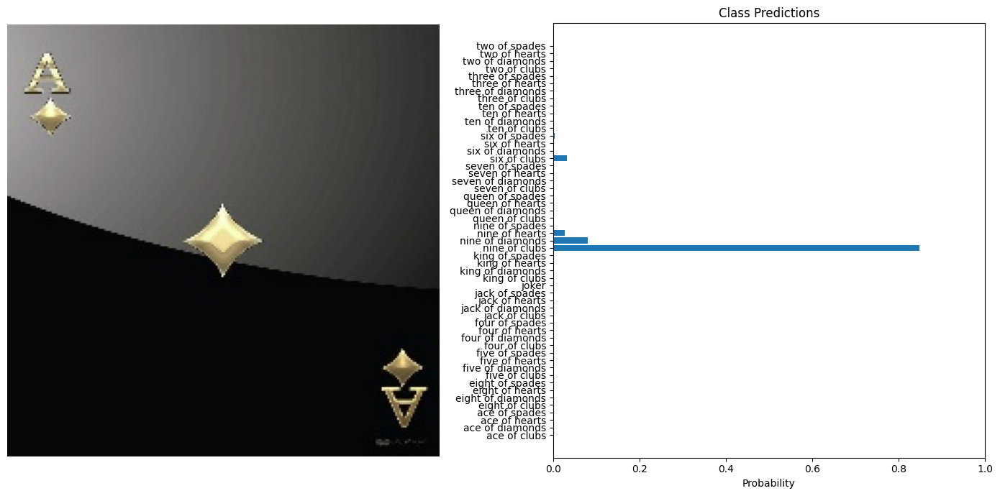

Processing images:  36%|███▋      | 47/129 [00:46<01:21,  1.00it/s]


Image: 084.jpg - Predicted Card: ten of diamonds


KeyboardInterrupt: 

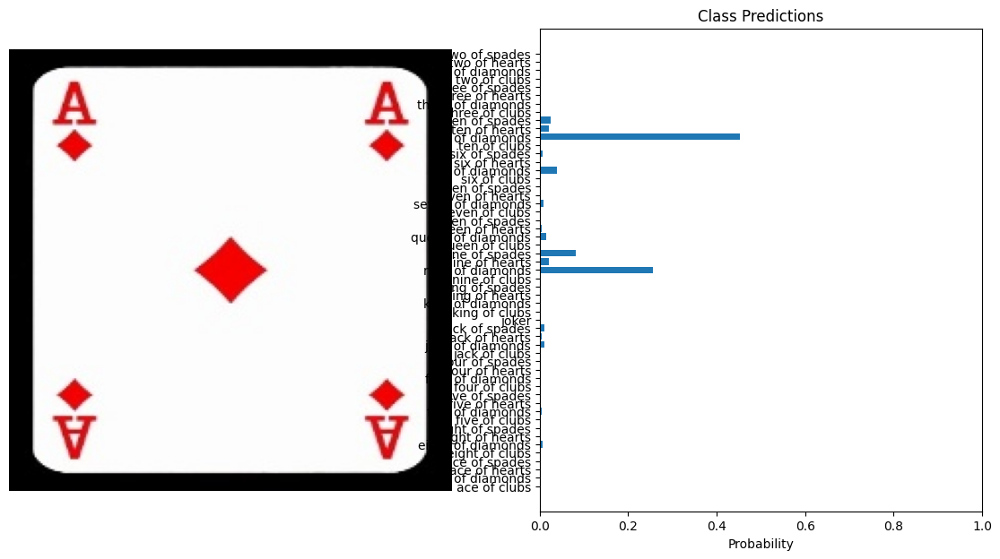

In [33]:
import torch
import os
from PIL import Image
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm


def preprocess_image(image_path, transform):
    image = Image.open(image_path).convert("RGB")
    return image, transform(image).unsqueeze(0)

# Function to make a prediction
def predict(model, image_tensor, device):
    model.eval()
    with torch.no_grad():  # Turn off gradient tracking for inference
        image_tensor = image_tensor.to(device)  # Move image tensor to the appropriate device
        outputs = model(image_tensor)  # Get model's raw outputs
        probabilities = torch.nn.functional.softmax(outputs, dim=1)  # Convert logits to probabilities
    return probabilities.cpu().numpy().flatten()  # Return the probabilities as a numpy array

# Load the model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = CardClassifier(num_classes=53)  # Initialize your model architecture
model.load_state_dict(torch.load('card_classifier.pth'))  # Load the trained model
model.to(device)

# Image transformation (resize, normalize, etc.)
transform = transforms.Compose([
    transforms.Resize((128, 128)),  # Resize image to match the input size used during training
    transforms.ToTensor(),          # Convert image to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize with standard values
])

# Assuming class_names is a dictionary of your card classes
class_names = {0: 'ace of clubs', 1: 'ace of diamonds', 2: 'ace of hearts', 3: 'ace of spades', 4: 'eight of clubs', 5: 'eight of diamonds', 6: 'eight of hearts', 7: 'eight of spades', 8: 'five of clubs', 9: 'five of diamonds', 10: 'five of hearts', 11: 'five of spades', 12: 'four of clubs', 13: 'four of diamonds', 14: 'four of hearts', 15: 'four of spades', 16: 'jack of clubs', 17: 'jack of diamonds', 18: 'jack of hearts', 19: 'jack of spades', 20: 'joker', 21: 'king of clubs', 22: 'king of diamonds', 23: 'king of hearts', 24: 'king of spades', 25: 'nine of clubs', 26: 'nine of diamonds', 27: 'nine of hearts', 28: 'nine of spades', 29: 'queen of clubs', 30: 'queen of diamonds', 31: 'queen of hearts', 32: 'queen of spades', 33: 'seven of clubs', 34: 'seven of diamonds', 35: 'seven of hearts', 36: 'seven of spades', 37: 'six of clubs', 38: 'six of diamonds', 39: 'six of hearts', 40: 'six of spades', 41: 'ten of clubs', 42: 'ten of diamonds', 43: 'ten of hearts', 44: 'ten of spades', 45: 'three of clubs', 46: 'three of diamonds', 47: 'three of hearts', 48: 'three of spades', 49: 'two of clubs', 50: 'two of diamonds', 51: 'two of hearts', 52: 'two of spades'}

# Folder containing images (test folder)
image_folder = "/content/drive/MyDrive/dataset_cards/train/ace of diamonds/"  # Folder with your images
image_paths = [os.path.join(image_folder, filename) for filename in os.listdir(image_folder) if filename.endswith(('.jpg', '.png'))]  # Collect image paths

# Iterate through the folder and predict for each image
for image_path in tqdm(image_paths, desc="Processing images"):
    original_image, image_tensor = preprocess_image(image_path, transform)  # Preprocess the image

    # Predict the class
    probabilities = predict(model, image_tensor, device)

    # Get predicted class
    predicted_class_index = np.argmax(probabilities)
    predicted_class_name = class_names[predicted_class_index]

    # Print the prediction for this image
    print(f"Image: {os.path.basename(image_path)} - Predicted Card: {predicted_class_name}")

    # Visualize the image and prediction
    def visualize_predictions(original_image, probabilities, class_names):
        fig, axarr = plt.subplots(1, 2, figsize=(14, 7))

        # Display the image
        axarr[0].imshow(original_image)
        axarr[0].axis("off")

        # Display the prediction bar chart
        axarr[1].barh(list(class_names.values()), probabilities)
        axarr[1].set_xlabel("Probability")
        axarr[1].set_title("Class Predictions")
        axarr[1].set_xlim(0, 1)

        plt.tight_layout()
        plt.show()

    # Visualize the result for this image
    visualize_predictions(original_image, probabilities, class_names)
